In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
from scipy import sparse 
import itertools

import matplotlib.pyplot as plt
import collections
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


In [2]:
outdir     = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results"

In [3]:
outfigdir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3"
!mkdir -p $outfigdir
fig_manager = powerplots.FigManager(outfigdir)

/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3


In [4]:
adata_raw = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_IT.h5ad")
adata_raw = adata_raw[adata_raw.obs['Subclass']=='L2/3']
adata_raw = adata_raw[adata_raw.obs['cond'].isin(['P28NR', 'P28DR'])]
counts = adata_raw.X
allgenes = adata_raw.var.index.values
adata_raw

View of AnnData object with n_obs × n_vars = 8748 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [5]:
# get updated cell types
f = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/allL23_newtypes.csv"
meta = pd.read_csv(f, index_col=0)
meta

/tmp/ipykernel_19223/12491127.py:3: DtypeWarning: Columns (1,4) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(f, index_col=0)


,Class_broad,Doublet,Doublet Score,batch,leiden,n_counts,n_genes,percent_mito,sample,Type,Subclass,cond,easitype,umap1,umap2,easisample,easicond,newtype
AAACGCTCACTTCATT-1-P8_1a-P8,Excitatory,False,0.025713,1,0,23384.0,4943,0.000128,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGGATAGGTGCATG-1-P8_1a-P8,Excitatory,False,0.011883,1,0,17774.0,4698,0.000169,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGGGCCAGTATACC-1-P8_1a-P8,Excitatory,False,0.024667,1,0,15872.0,4173,0.000126,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGTCCCATATACCG-1-P8_1a-P8,Excitatory,False,0.027921,1,0,20076.0,4761,0.000050,P8_1a,L2/3_AB,L2/3,P8NR,L2/3_A,NaN,NaN,1a,1-P08NR,L2/3_A
AAAGTCCTCAGATGCT-1-P8_1a-P8,Excitatory,False,0.009527,1,4,19061.0,4601,0.000000,P8_1a,L2/3_BC,L2/3,P8NR,L2/3_C,NaN,NaN,1a,1-P08NR,L2/3_C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAGTTGTTG-1-P38_dr_1a,NaN,False,0.042872,11,1,11379.0,3568,0.000879,P38_dr_1a,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,1a,2-P38DR,L2/3_B
TTTGGTTTCTGCCTGT-1-P38_dr_2b,NaN,False,0.007108,2,1,16050.0,3104,0.000062,P38_dr_2b,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,2b,2-P38DR,L2/3_B
TTTGTTGCACCGGTCA-1-P38_dr_2a,NaN,False,0.030928,2,1,13955.0,3739,0.001146,P38_dr_2a,L2/3_3,L2/3,P38DR,L2/3_C,NaN,NaN,2a,2-P38DR,L2/3_B
TTTGTTGGTGGCTAGA-1-P38_dr_2b,NaN,False,0.015884,3,4,7272.0,2789,0.000963,P38_dr_2b,L2/3_2,L2/3,P38DR,L2/3_B,NaN,NaN,2b,2-P38DR,L2/3_A


In [6]:
# update new type 
adata_raw.obs['newtype'] = adata_raw.obs['Type'].copy()
adata_raw.obs.update(meta[['newtype']])

/tmp/ipykernel_19223/3478751590.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw.obs['newtype'] = adata_raw.obs['Type'].copy()


In [7]:
conds = adata_raw.obs['cond'].values
types = adata_raw.obs['Type'].values
newtypes = adata_raw.obs['newtype'].values
samps = adata_raw.obs['sample'].values

rename_dict = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}

def rename(x):
    """
    """
    if x in rename_dict.keys():
        return rename_dict[x]
    else:
        return x
    
adata_raw.obs['easitype'] = adata_raw.obs['Type'].apply(rename)

In [8]:
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/P28NR_ITgrad_genes_n749_n338unq_230420.csv'
df2 = pd.read_csv(f)
genes_it = df2['gene'].unique()
# genes_it

In [9]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_l23 = df['gene'].values
# genes_sel = adata_raw.var.index.values
# genes_grp = df['P17on'].astype(str).values
# assert len(genes_sel) == len(np.unique(genes_sel))

# Use P28 ordering
f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
gpt = pd.read_csv(f)
gpt = gpt['gene_ptime'].values
gptidx = np.argsort(gpt)

In [10]:
genes_it.shape, genes_l23.shape, np.intersect1d(genes_it, genes_l23).shape

((338,), (286,), (89,))

In [11]:
# filter genes
cond = np.ravel((adata_raw.X>0).sum(axis=0)) > 10 # expressed in more than 10 cells
adata_sub = adata_raw[:,cond]

# counts
x = adata_sub.X
cov = adata_sub.obs['n_counts'].values
genes = adata_sub.var.index.values

# CP10k
xn = (sparse.diags(1/cov).dot(x))*1e4

# log10(CP10k+1)
xln = xn.copy()
xln.data = np.log10(xln.data+1)

adata_sub.layers['norm'] = xn
adata_sub.layers['lognorm'] = xln

In [12]:
adata_sub.shape

(8748, 21222)

In [13]:
# select HVGs with mean and var
nbin = 20
qth = 0.3

# min
gm = np.ravel(xn.mean(axis=0))

# var
tmp = xn.copy()
tmp.data = np.power(tmp.data, 2)
gv = np.ravel(tmp.mean(axis=0))-gm**2

# cut 
lbl = pd.qcut(gm, nbin, labels=np.arange(nbin))
gres = pd.DataFrame()
gres['name'] = genes
gres['lbl'] = lbl
gres['mean'] = gm
gres['var'] = gv
gres['ratio']= gv/gm

# select
gres_sel = gres.groupby('lbl')['ratio'].nlargest(int(qth*(len(gm)/nbin))) #.reset_index()
gsel_idx = np.sort(gres_sel.index.get_level_values(1).values)

assert np.all(gsel_idx != -1)

In [14]:
l23_gidx = basicu.get_index_from_array(genes, genes_l23)
assert np.all(l23_gidx != -1)

it_gidx = basicu.get_index_from_array(genes, genes_it)
assert np.all(it_gidx != -1)

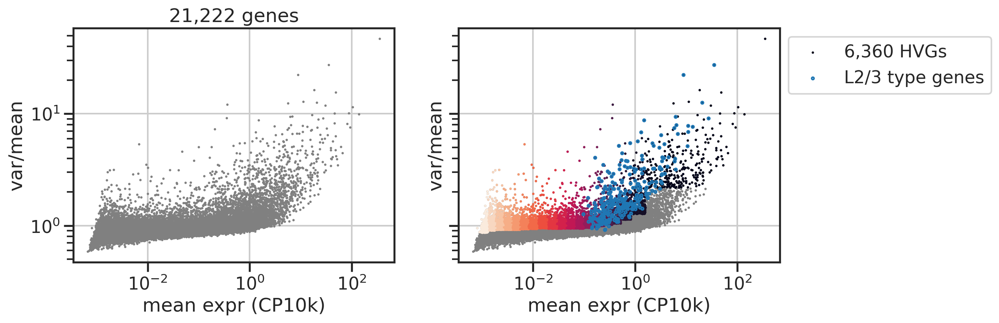

In [15]:
fig, axs = plt.subplots(1,2, figsize=(6*2,4), sharex=True, sharey=True)
ax = axs[0]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.set_title(f'{len(gm):,} genes')

ax = axs[1]
ax.scatter(gm, gv/gm, s=5, edgecolor='none', color='gray')
ax.scatter(gm[gsel_idx], (gv/gm)[gsel_idx], c=lbl[gsel_idx], s=5, edgecolor='none', cmap='rocket_r', label=f'{len(gsel_idx):,} HVGs')
ax.scatter(gm[l23_gidx], (gv/gm)[l23_gidx], s=5, facecolors='none', edgecolor='C0', label='L2/3 type genes')
# ax.scatter(gm[it_gidx], (gv/gm)[it_gidx], s=5, facecolors='none', edgecolor='C1', label='IT genes')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean expr (CP10k)')
ax.set_ylabel('var/mean')
ax.legend(bbox_to_anchor=(1,1))

plt.show()

In [16]:
adata = adata_sub[:,gsel_idx]
# adata = adata_sub[:,it_gidx]
genes_sel = adata.var.index.values
lognorm = np.array(adata.layers['lognorm'].todense())
zlognorm = zscore(lognorm, axis=0)
adata

View of AnnData object with n_obs × n_vars = 8748 × 6360
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond', 'newtype', 'easitype'
    layers: 'norm', 'lognorm'

In [17]:
hvgs = adata.var.index.values
hvgs

array(['Xkr4', 'Gm1992', 'Gm10568', ..., 'Tmlhe', 'CAAA01118383.1',
       'CAAA01147332.1'], dtype=object)

In [18]:
np.savetxt(os.path.join(outdir, 'p28_l23_hvgs6360.txt'), hvgs, fmt='%s')

In [19]:
xn.shape, genes.shape

((8748, 21222), (21222,))

In [20]:
gcov = np.array(xn.sum(axis=0)).reshape(-1,)
gcov.shape

(21222,)

In [21]:
gidx_top5000 = np.argsort(gcov)[-5000:]
genes_top5000 = genes[gidx_top5000]
genes_top5000

array(['Slc39a14', 'Lmna', 'Mtm1', ..., 'Kcnip4', 'Ptprd', 'Malat1'],
      dtype=object)

In [22]:
np.savetxt(os.path.join(outdir, 'p28_l23_highly_expressed5000.txt'), genes_top5000, fmt='%s')

In [23]:
gidx_top10000 = np.argsort(gcov)[-10000:]
genes_top10000 = genes[gidx_top10000]
genes_top10000

array(['Zfp459', 'Adra2c', 'Ache', ..., 'Kcnip4', 'Ptprd', 'Malat1'],
      dtype=object)

In [24]:
np.savetxt(os.path.join(outdir, 'p28_l23_highly_expressed10000.txt'), genes_top10000, fmt='%s')

In [25]:
%%time
np.random.seed(0)
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)

CPU times: user 4.03 s, sys: 107 ms, total: 4.13 s
Wall time: 4.14 s


In [26]:
# use enrichr API - network issues on hoffman2
output = os.path.join(outfigdir, 'pc1_top100.txt')
pc1_v = pca.components_[0]
pc1_idx = np.argsort(np.abs(pc1_v))[::-1]
np.savetxt(output, genes_sel[pc1_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc2_top100.txt')
pc2_v = pca.components_[1]
pc2_idx = np.argsort(np.abs(pc2_v))[::-1]
np.savetxt(output, genes_sel[pc2_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc3_top100.txt')
pc3_v = pca.components_[2]
pc3_idx = np.argsort(np.abs(pc3_v))[::-1]
np.savetxt(output, genes_sel[pc3_idx[:100]], fmt='%s')

output = os.path.join(outfigdir, 'pc4_top100.txt')
pc4_v = pca.components_[3]
pc4_idx = np.argsort(np.abs(pc4_v))[::-1]
np.savetxt(output, genes_sel[pc4_idx[:100]], fmt='%s')

In [27]:
# get results
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
res['cond'] = conds
res['type'] = types
res['newtype'] = newtypes
res['samp'] = samps
res['biosamp'] = res['samp'].apply(lambda x: x[:-1])
res

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC46,PC47,PC48,PC49,PC50,cond,type,newtype,samp,biosamp
0,4.427574,-9.689575,1.838100,7.823696,-4.414395,-1.896761,-6.279951,-0.899448,0.840928,0.964643,...,-1.182510,0.605676,2.086090,0.125553,2.960668,P28NR,L2/3_C,L2/3_B,P28_1a,P28_1
1,-6.982104,-9.374796,3.692419,-11.023370,1.974242,0.040729,-0.917303,-1.941763,4.870699,1.141912,...,-0.574535,1.379102,0.546908,0.253976,1.073393,P28NR,L2/3_B,L2/3_B,P28_1a,P28_1
2,-5.731854,-5.830597,2.786370,9.163280,-1.070912,-2.382400,-3.545518,-1.272021,0.311386,-1.647582,...,-0.569469,-1.178384,-0.655535,0.733005,0.123584,P28NR,L2/3_C,L2/3_C,P28_1a,P28_1
3,-2.059380,-8.856082,13.184319,15.744245,-1.688463,3.065937,2.031680,-5.289433,-0.450143,1.207836,...,1.976527,-0.436625,-2.618745,1.488504,0.108784,P28NR,L2/3_C,L2/3_C,P28_1a,P28_1
4,-5.781182,-9.082471,-4.214498,-2.361595,1.417883,0.660405,-4.626880,1.556379,0.718383,2.210176,...,-1.295968,1.642243,-4.633156,-7.922113,-9.671767,P28NR,L2/3_B,L2/3_B,P28_1a,P28_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8743,29.354868,-0.272520,-1.687855,1.528531,0.074011,-1.174667,-1.913088,2.053921,-0.550481,-1.202533,...,-2.174250,-2.001524,-0.071402,1.616616,-2.133347,P28DR,L2/3_2,L2/3_A,P28_dr_1b,P28_dr_1
8744,9.745014,-2.647578,8.376806,-10.320633,2.782376,-1.697450,1.826515,1.812233,0.835528,-3.699717,...,0.232614,-0.025625,-2.857793,3.615030,-1.100050,P28DR,L2/3_1,L2/3_B,P28_dr_1a,P28_dr_1
8745,2.449623,9.421876,-10.784611,4.190981,0.889796,4.251648,-0.134767,-3.612043,1.616626,-3.088717,...,2.943606,0.306836,0.653901,-1.821047,-1.060516,P28DR,L2/3_2,L2/3_A,P28_dr_3b,P28_dr_3
8746,-0.977708,6.683939,-0.897308,14.920720,4.766356,-2.481108,-2.468378,-4.990700,3.013267,3.632253,...,1.041367,0.872227,-1.966558,-2.156929,-1.080933,P28DR,L2/3_2,L2/3_C,P28_dr_3a,P28_dr_3


Text(0, 0.5, 'explained var')

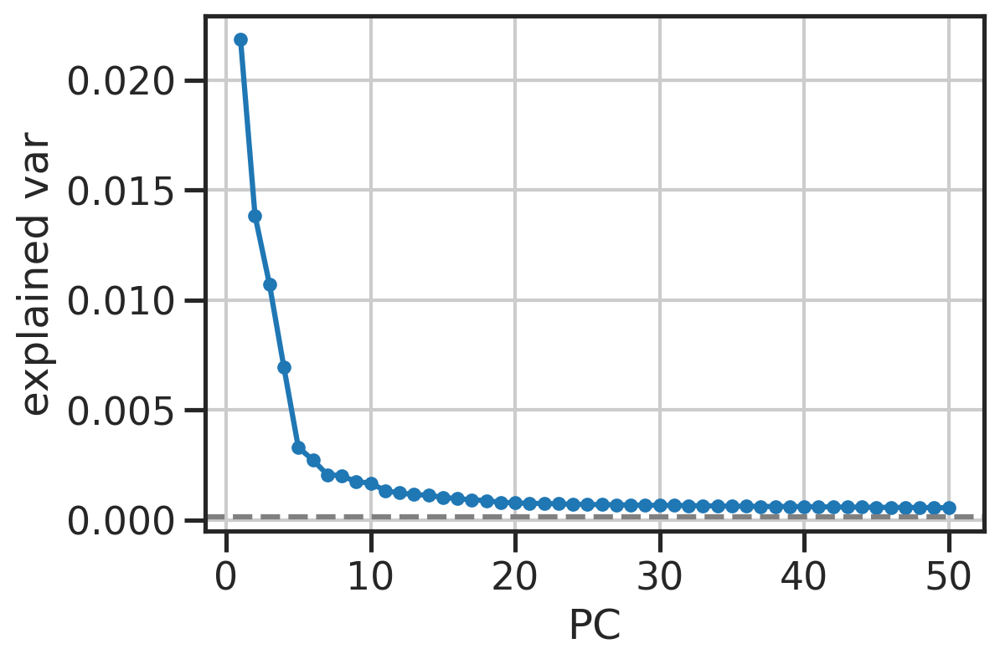

In [28]:
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

<function seaborn.utils.despine(fig=None, ax=None, top=True, right=True, left=False, bottom=False, offset=None, trim=False)>

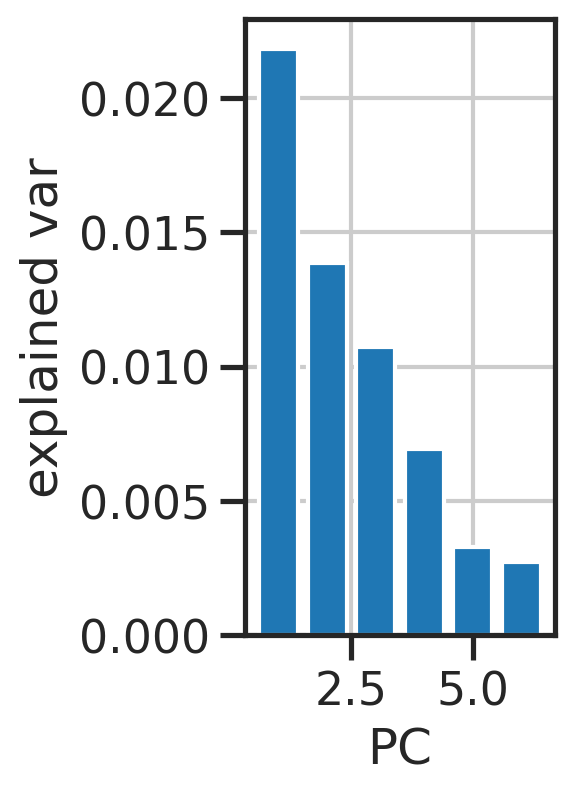

In [29]:
fig, ax = plt.subplots(figsize=(2,4))
ax.bar(np.arange(6)+1, pca.explained_variance_ratio_[:6],)
# ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')
sns.despine

In [30]:
colors2 = sns.color_palette('tab10', 10)
colors2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [31]:
colors = sns.color_palette('tab20', 10)
# 6-9
palette_biosamp = {
    'P28_1': colors[6],
    'P28_2': colors[7],
    'P28_dr_1': colors[8],
    'P28_dr_3': colors[9],
}
palette_cond = {
    'P28NR': 'C1', # colors[6],
    'P28DR': 'k', # colors[8],
}

# 0-5
palette_type = {
    'L2/3_A': colors[0],
    'L2/3_B': colors[2],
    'L2/3_C': colors[4],
    
    'L2/3_1': colors[1],
    'L2/3_2': colors[3],
    'L2/3_3': colors[5],
    'bg': 'lightgray',
}

palette_type_abc = {
    'L2/3_A': colors[0],
    'L2/3_B': colors[2],
    'L2/3_C': colors[4],
    
    'L2/3_1': 'lightgray',
    'L2/3_2': 'lightgray',
    'L2/3_3': 'lightgray',
}

palette_type2 = {}
palette_type2['L2/3_A'] = 'C0' # palette_type['L2/3_A']
palette_type2['L2/3_B'] = 'C1' # palette_type['L2/3_B']
palette_type2['L2/3_C'] = 'C2' # palette_type['L2/3_C']
palette_type2['L2/3_1'] = 'C5' # palette_type['L2/3_A']
palette_type2['L2/3_2'] = 'C6' # palette_type['L2/3_B']
palette_type2['L2/3_3'] = 'C8' # palette_type['L2/3_C']
palette_type2['NA'] = 'gray' # palette_type['L2/3_C']

palette_type3 = {}
palette_type3['L2/3_A'] = 'C0' # palette_type['L2/3_A']
palette_type3['L2/3_B'] = 'C1' # palette_type['L2/3_B']
palette_type3['L2/3_C'] = 'C2' # palette_type['L2/3_C']
palette_type3['L2/3_1'] = 'lightgray' # palette_type['L2/3_A']
palette_type3['L2/3_2'] = 'lightgray' # palette_type['L2/3_B']
palette_type3['L2/3_3'] = 'lightgray' # palette_type['L2/3_C']

colors

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589)]

In [32]:
def plot_pcs(res, npc, hue, palette=None):
    fig, axs = plt.subplots(npc-1,npc-1,figsize=(6*(npc-1),5*(npc-1)))
    for i, j in itertools.combinations(range(npc), 2):
        legend = False
        if (i,j) == (0,1): legend=True

        x, y = f"PC{j+1}", f"PC{i+1}"
        ax = axs[i,j-1]
        
        if palette is not None:
            sns.scatterplot(data=res.sample(frac=1, replace=False), 
                            x=x, y=y, 
                            hue=hue,
                            hue_order=list(palette.keys()),
                            palette=palette,
                            s=5, edgecolor='none', 
                            legend=legend,
                            ax=ax,
                           )
        else:
            sns.scatterplot(data=res.sample(frac=1, replace=False), 
                            x=x, y=y, 
                            hue=hue,
                            # hue_order=list(palette.keys()),
                            # palette=palette,
                            s=5, edgecolor='none', 
                            legend=legend,
                            ax=ax,
                           )
        sns.despine(ax=ax)
    axs[0,0].legend(bbox_to_anchor=(0.5, -0.2), loc='upper center')

    for i, j in itertools.product(range(npc-1), range(npc-1)):
        if j<i:
            ax = axs[i,j]
            ax.axis('off')

    plt.show()

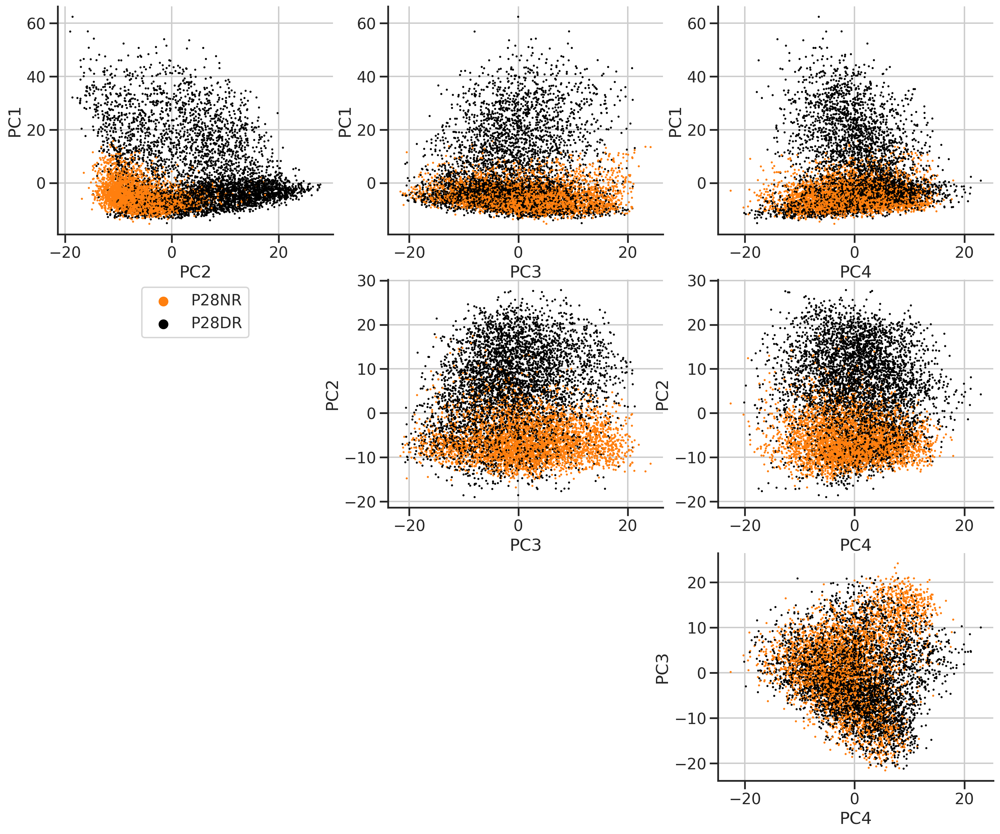

In [33]:
plot_pcs(res, 4, 'cond', palette=palette_cond)

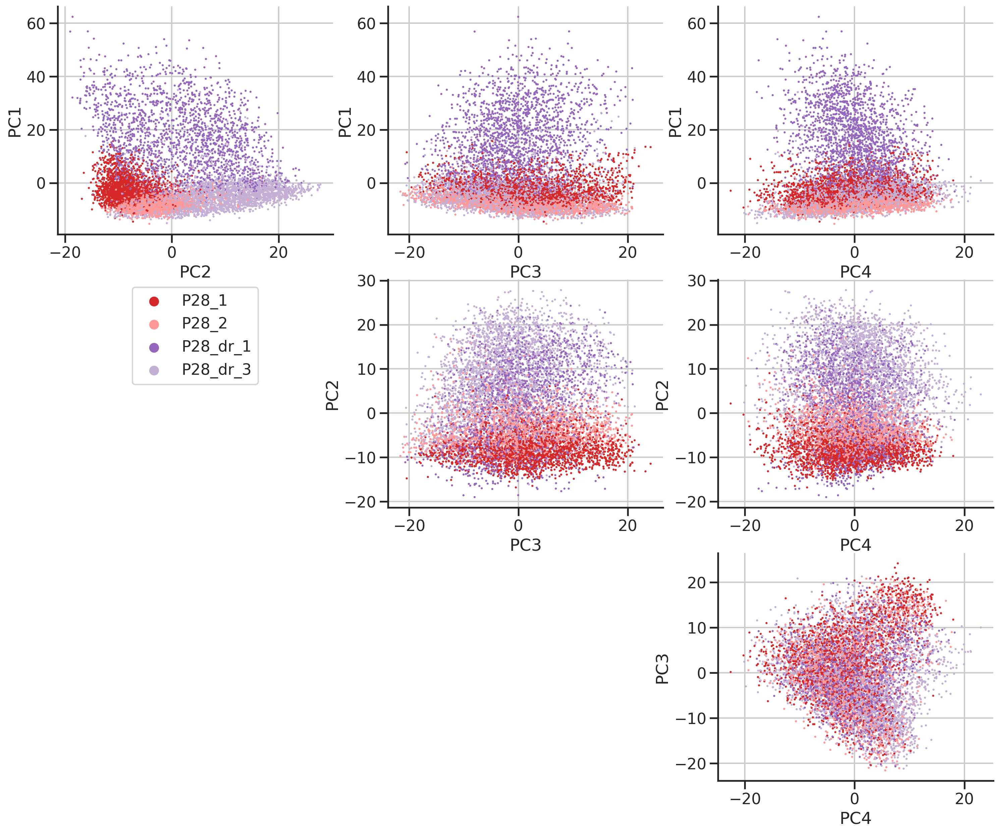

In [34]:
plot_pcs(res, 4, 'biosamp', palette=palette_biosamp)

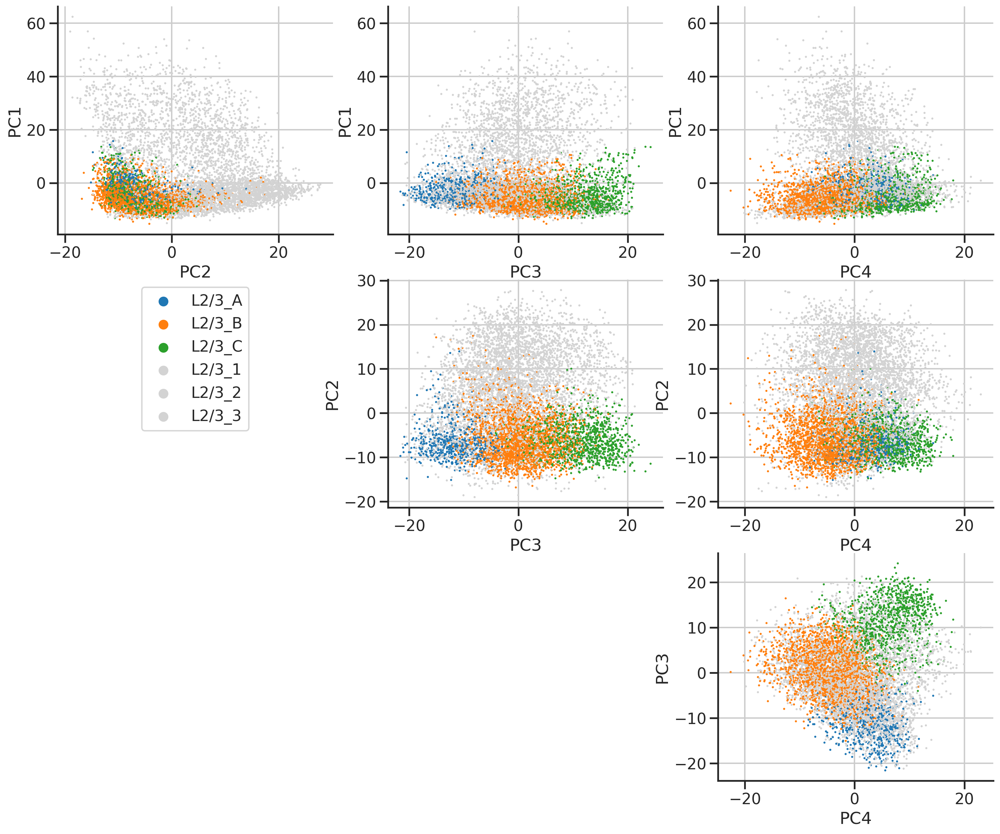

In [35]:
plot_pcs(res, 4, 'type', palette=palette_type_abc)

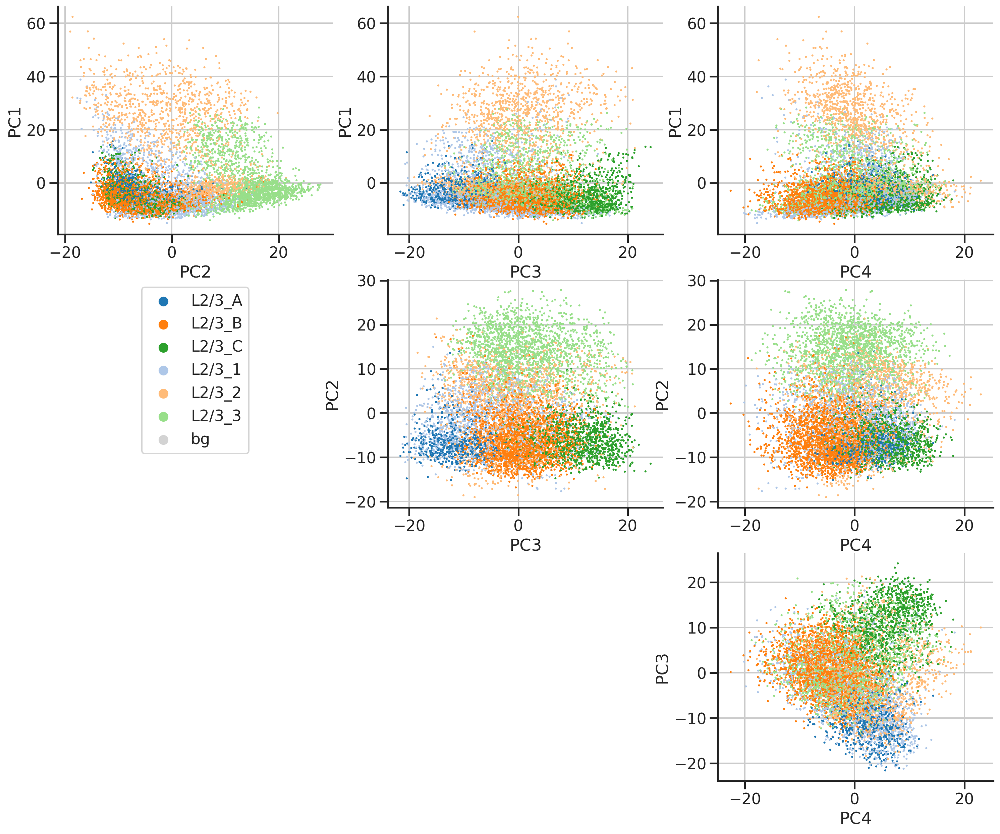

In [36]:
plot_pcs(res, 4, 'type', palette=palette_type)

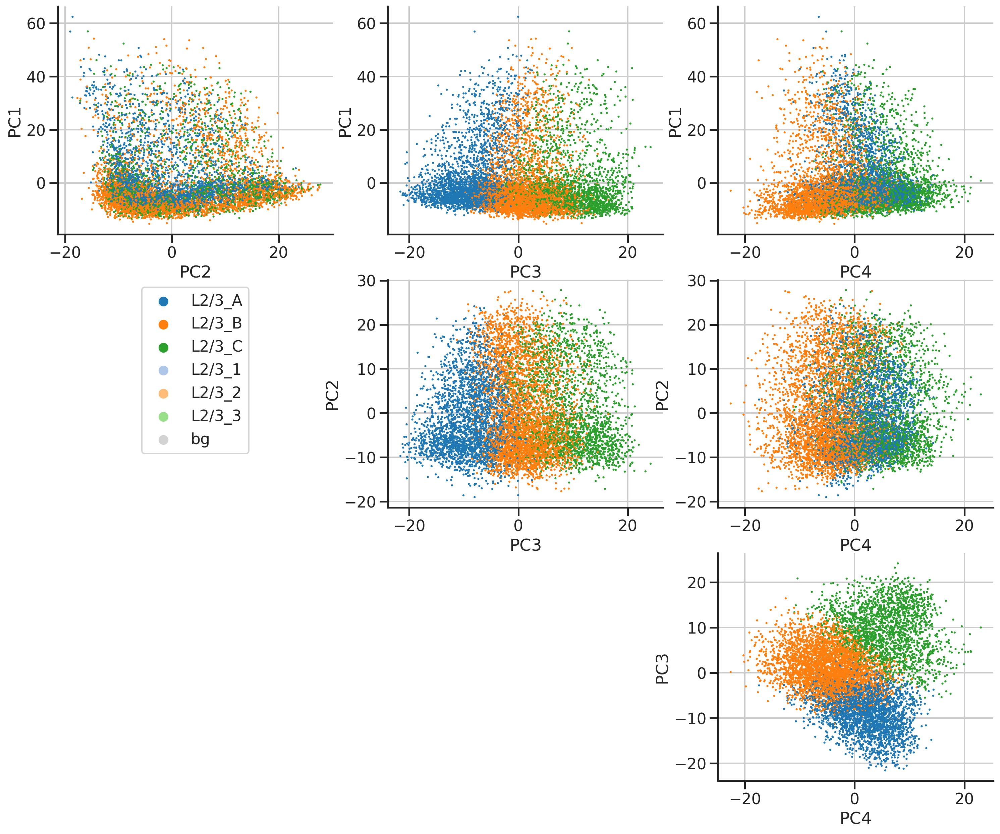

In [37]:
plot_pcs(res, 4, 'newtype', palette=palette_type)

In [38]:
res['newtype2'] = res['newtype'].copy()
res.loc[res['cond']=='P28DR', 'newtype2'] = res.loc[res['cond']=='P28DR', 'newtype2'] + 'p'

res['newtype_nr'] = res['newtype'].copy()
res.loc[res['cond']=='P28DR', 'newtype_nr'] = 'bg'

res['newtype_dr'] = res['newtype'].copy()
res.loc[res['cond']=='P28NR', 'newtype_dr'] = 'bg'

res['type_dr'] = res['type'].copy().astype(str)
res.loc[res['cond']=='P28NR', 'type_dr'] = 'bg'

In [39]:
res[res['cond']=='P28DR']['type'].unique()

['L2/3_3', 'L2/3_1', 'L2/3_2']
Categories (6, object): ['L2/3_1', 'L2/3_2', 'L2/3_3', 'L2/3_A', 'L2/3_B', 'L2/3_C']

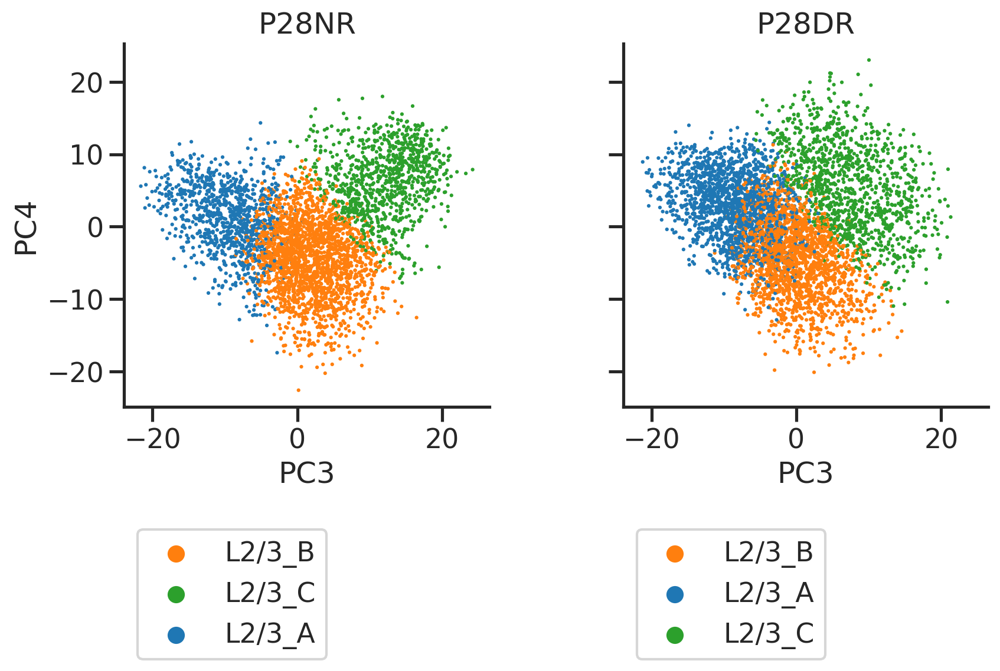

In [40]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res[res['cond']=='P28NR'], x='PC3', y='PC4', hue='newtype', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28NR')

ax = axs[1]
sns.scatterplot(data=res[res['cond']=='P28DR'], x='PC3', y='PC4', hue='newtype', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28DR')


output = os.path.join(outfigdir, "figS1_nr_pc34.pdf")
powerplots.savefig(fig, output)
plt.show()

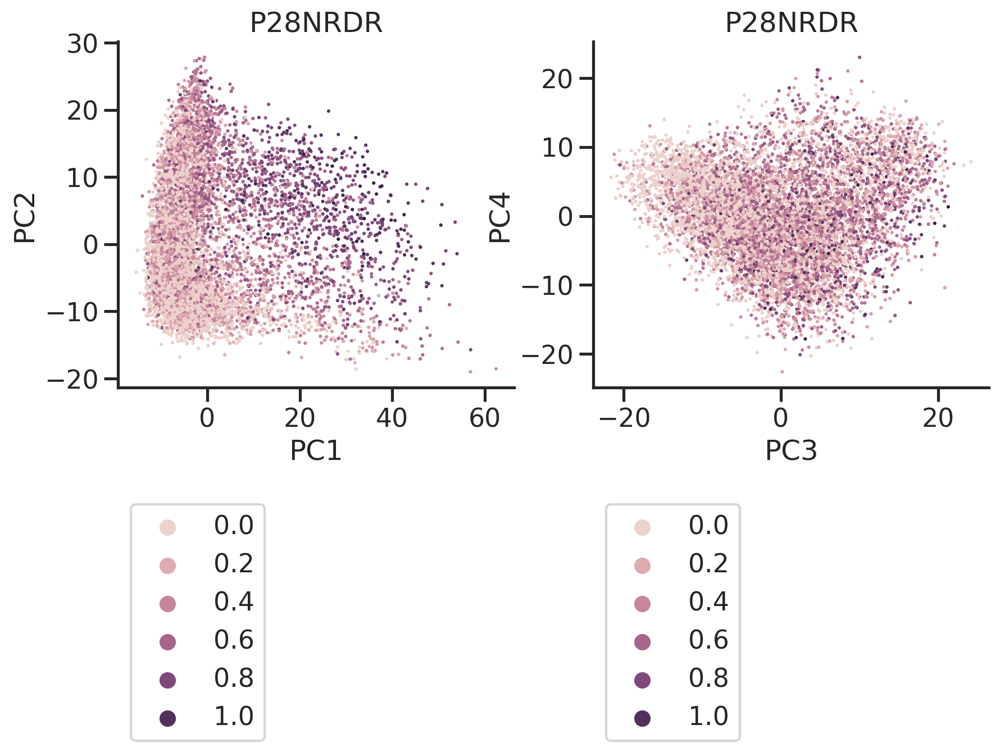

In [41]:
gexp = np.array(adata[:,'Arc'].layers['lognorm'].todense()).reshape(-1,)
res['gexp'] = gexp

fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC1', y='PC2', hue='gexp', s=5, 
                edgecolor='none', ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# ax.set_aspect('equal')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC3', y='PC4', hue='gexp', s=5, 
                edgecolor='none', ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# ax.set_aspect('equal')

sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

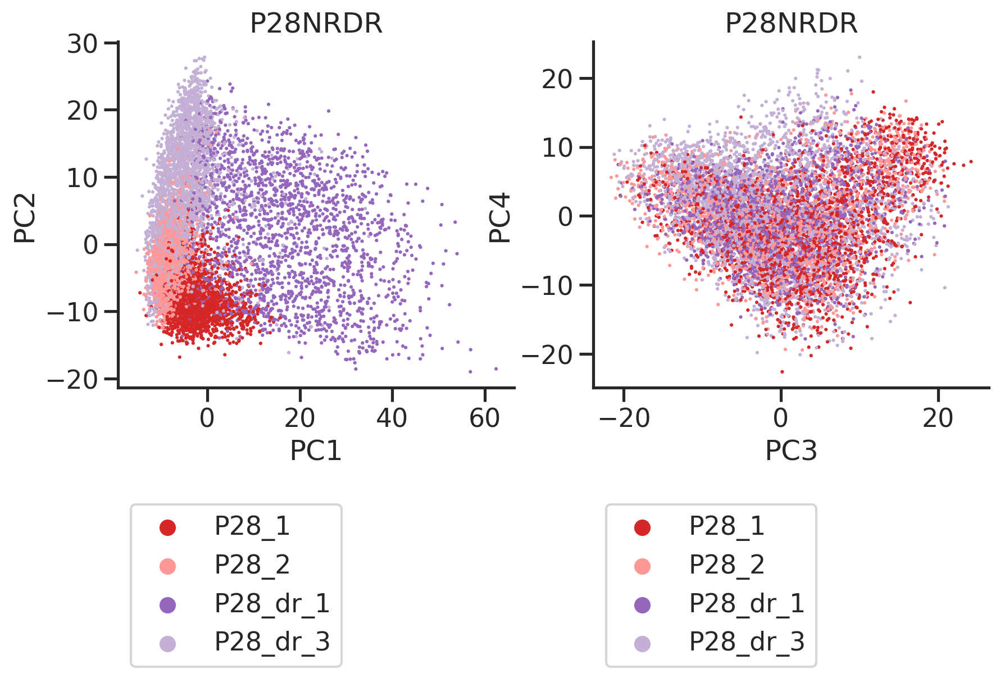

In [42]:

fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC1', y='PC2', hue='biosamp', s=5, 
                edgecolor='none', hue_order=list(palette_biosamp), palette=palette_biosamp, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# ax.set_aspect('equal')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC3', y='PC4', hue='biosamp', s=5, 
                edgecolor='none', hue_order=list(palette_biosamp), palette=palette_biosamp, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# ax.set_aspect('equal')

sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

In [43]:

# fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
# ax = axs[0]
# sns.scatterplot(data=res_nr.sample(frac=1, replace=False), x='PC1', y='PC2', hue='newtype', s=5, 
#                 edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
# ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# sns.despine(ax=ax)
# ax.grid(False)
# ax.set_title('P28NRDR')

# ax = axs[1]
# sns.scatterplot(data=res_nr.sample(frac=1, replace=False), x='PC3', y='PC4', hue='newtype', s=5, 
#                 edgecolor='none', hue_order=list(palette_type2), palette=palette_type2, ax=ax, rasterized=True)
# ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
# sns.despine(ax=ax)
# ax.grid(False)
# ax.set_title('P28NRDR')

# output = os.path.join(outfigdir, "figS1_pc34_newtype.pdf")
# powerplots.savefig(fig, output)
# plt.show()

In [44]:
from sklearn.neighbors import NearestNeighbors

def neighbor_label_transfer(k, ref_emb, qry_emb, ref_lbl, p_cutoff=0.5, dist_cutoff=None):
    """ref vs qry neighbors
    """
    unq_lbls = np.unique(ref_lbl).astype(str) # array(['L2/3_A', 'L2/3_B', 'L2/3_C'])
    n_unq_lbls = len(unq_lbls)
    ref_n = len(ref_emb)
    qry_n = len(qry_emb)
    
    neigh = NearestNeighbors(n_neighbors=k) # , radius=0.4)
    neigh.fit(ref_emb)
    dists, idx = neigh.kneighbors(qry_emb, k, return_distance=True)
    
    raw_pred = ref_lbl[idx]

    # p
    pabc = np.empty((qry_n, n_unq_lbls))
    for i, lbl in enumerate(unq_lbls):
        p = np.sum(raw_pred==lbl, axis=1)/k
        pabc[:,i] = p

    # max
    max_pred = unq_lbls[np.argmax(pabc, axis=1)]

    # 
    gated_pred = max_pred.copy()
    cond1 = np.max( pabc, axis=1) > p_cutoff
    gated_pred[~cond1] = 'NA'
    if dist_cutoff is not None:
        cond2 = np.max(dists, axis=1) < dist_cutoff
        gated_pred[~cond2] = 'NA'
    
    return max_pred, gated_pred

def neighbor_count(k, emb, cond, unq_lbls):
    """self neighbors
    """
    neigh = NearestNeighbors(n_neighbors=k)
    neigh.fit(emb)
    idx = neigh.kneighbors(emb, k, return_distance=False)
    idx = idx[:,1:]

    raw_pred = cond[idx]
    pall = np.empty((len(emb),len(unq_lbls)))
    for i, lbl in enumerate(unq_lbls):
        p = np.sum(raw_pred==lbl, axis=1)/k
        pall[:,i] = p

    logratio = np.log2((pall[:,0]+1/k)/(pall[:,1]+1/k))
    return pall, logratio

In [45]:
res_nr = res[res['cond'].str.contains('NR')].copy()
res_dr = res[res['cond'].str.contains('DR')].copy()
print(res_nr.shape, res_dr.shape)

(4044, 60) (4704, 60)


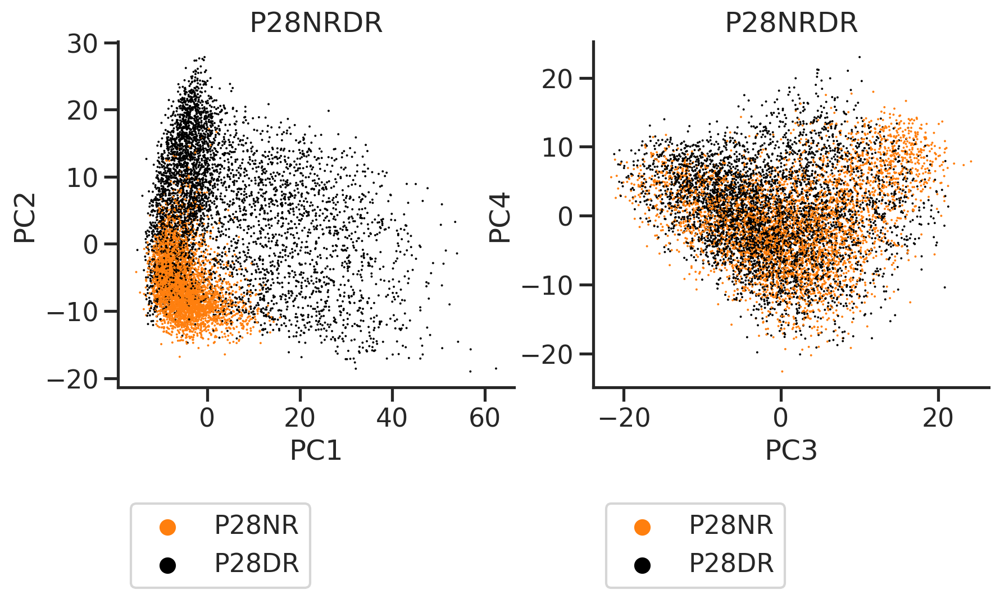

In [46]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC1', y='PC2', hue='cond', s=2, 
                edgecolor='none', hue_order=list(palette_cond), palette=palette_cond, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC3', y='PC4', hue='cond', s=2, 
                edgecolor='none', hue_order=list(palette_cond), palette=palette_cond, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')

sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "fig3_nrdr.pdf")
powerplots.savefig(fig, output)
plt.show()

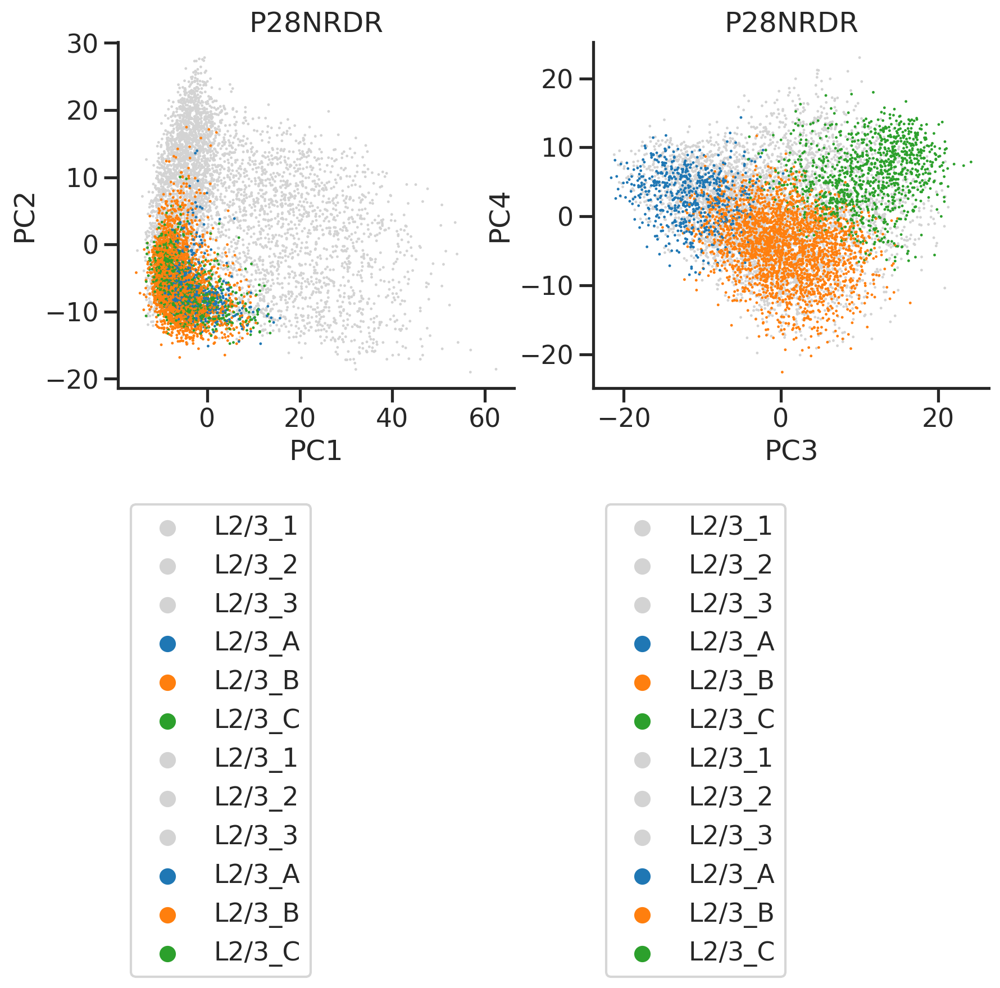

In [47]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res_dr.sample(frac=1, replace=False), x='PC1', y='PC2', hue='type', s=3, 
                edgecolor='none', #hue_order=list(palette_cond), 
                # palette=palette_cond, ax=ax, rasterized=True)
                palette=palette_type3, ax=ax, rasterized=True)
sns.scatterplot(data=res_nr.sample(frac=1, replace=False), x='PC1', y='PC2', hue='type', s=3, 
                edgecolor='none', #hue_order=list(palette_cond), 
                # palette=palette_cond, ax=ax, rasterized=True)
                palette=palette_type3, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res_dr.sample(frac=1, replace=False), x='PC3', y='PC4', hue='type', s=3, 
                edgecolor='none', #hue_order=list(palette_cond), 
                # palette=palette_cond, ax=ax, rasterized=True)
                palette=palette_type3, ax=ax, rasterized=True)
sns.scatterplot(data=res_nr.sample(frac=1, replace=False), x='PC3', y='PC4', hue='type', s=3, 
                edgecolor='none', #hue_order=list(palette_cond), 
                # palette=palette_cond, ax=ax, rasterized=True)
                palette=palette_type3, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "fig3_type.pdf")
powerplots.savefig(fig, output)
plt.show()

# projected variance

In [48]:
ratios = pca.explained_variance_ratio_
ratios[0]/ratios[1], np.std(res['PC1'])**2/np.std(res['PC2'])**2

(1.5783701, 1.578369542046971)

In [49]:
r12 = (np.std(res_nr['PC1'])**2+np.std(res_nr['PC2'])**2) / (np.std(res_dr['PC1'])**2+np.std(res_dr['PC2'])**2)
r34 = (np.std(res_nr['PC3'])**2+np.std(res_nr['PC4'])**2) / (np.std(res_dr['PC3'])**2+np.std(res_dr['PC4'])**2)

r12, r34

(0.1397457525423334, 1.1196370138606409)

In [50]:
nr_12vs34 = (np.std(res_nr['PC1'])**2+np.std(res_nr['PC2'])**2) / (np.std(res_nr['PC3'])**2+np.std(res_nr['PC4'])**2)
dr_12vs34 = (np.std(res_dr['PC1'])**2+np.std(res_dr['PC2'])**2) / (np.std(res_dr['PC3'])**2+np.std(res_dr['PC4'])**2)

In [51]:
1/nr_12vs34

2.894763945300476

In [52]:
bars = np.array([
    np.std(res['PC1'])**2,
    np.std(res_nr['PC1'])**2, 
    np.std(res_dr['PC1'])**2,
    
    np.std(res['PC2'])**2,
    np.std(res_nr['PC2'])**2, 
    np.std(res_dr['PC2'])**2,
    
    np.std(res['PC3'])**2,
    np.std(res_nr['PC3'])**2, 
    np.std(res_dr['PC3'])**2,
    
    np.std(res['PC4'])**2,
    np.std(res_nr['PC4'])**2, 
    np.std(res_dr['PC4'])**2,
])

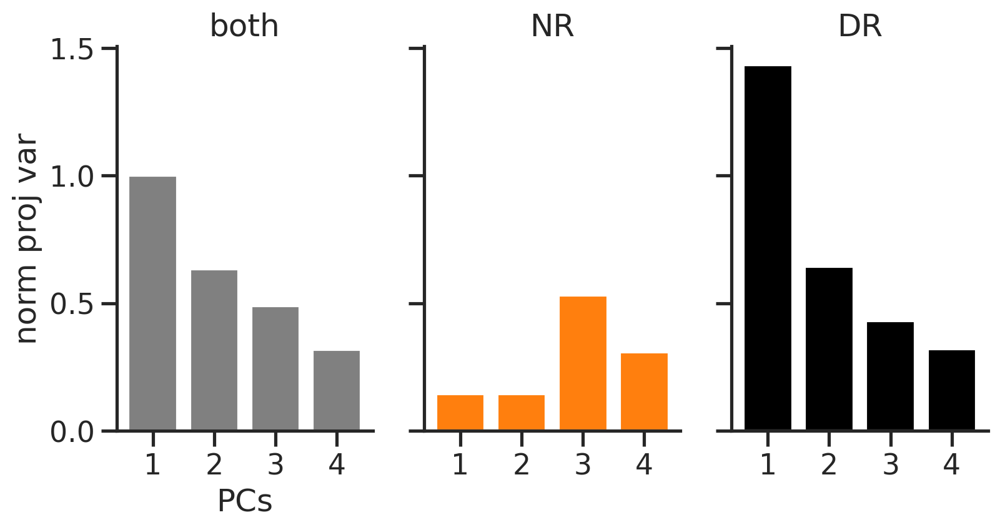

In [53]:
colors = ['gray', 'C1', 'k']
labels = ['both', 'NR', 'DR']

fig, axs = plt.subplots(1,3,figsize=(3*3,1*4), sharey=True, sharex=True)
for i in range(3):
    ax = axs[i]
    c = colors[i]
    lbl = labels[i]
    ax.bar(np.arange(4), bars[i::3]/bars[0], color=c, label=lbl)
    sns.despine(ax=ax)
    ax.grid(False)
    ax.set_title(lbl)
    
axs[0].set_xticks([0,1,2,3])
axs[0].set_xticklabels([1,2,3,4])
axs[0].set_ylabel('norm proj var')
axs[0].set_xlabel('PCs')
plt.show()

# Salt-and-pepper


In [54]:
def plot_gene(adata, gns):
    """
    """
    df = adata.obs.copy()
    gexp = np.array(adata[:,gns].layers['lognorm'].todense()) # .reshape(-1,)
    df[gns] = gexp

    n = len(gns)
    fig, axs = plt.subplots(1, n, figsize=(3.5*n,4))
    for ax, gn in zip(axs, gns):
        sns.boxplot(data=df, x='newtype', y=gn, 
                    order=['L2/3_A', 'L2/3_B', 'L2/3_C'],
                    hue='cond', 
                    hue_order=['P28NR', 'P28DR'],
                    palette=['C1', 'gray'], 
                    ax=ax, 
                   )
        ax.legend().remove()
        sns.despine(ax=ax)
        ax.set_xticklabels(['A', 'B', 'C'])
        ax.set_xlabel('')
        ax.set_ylabel('log expr')
        ax.set_title(gn)
    fig.tight_layout()
    plt.show()

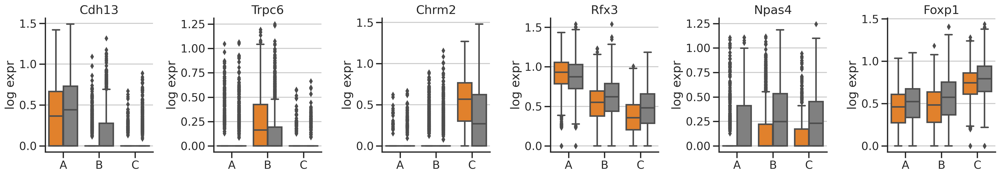

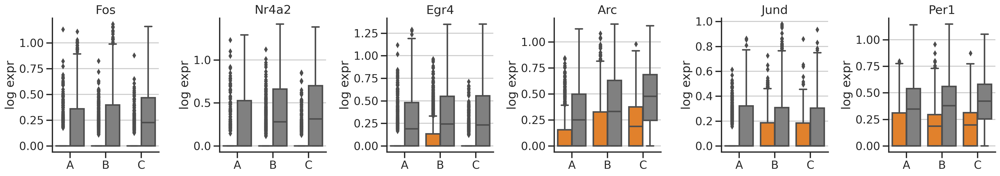

In [55]:
gns = ['Cdh13', 'Trpc6', 'Chrm2', 
       'Rfx3', 'Npas4', 'Foxp1',
      ]
plot_gene(adata, gns)

gns = ['Fos', 'Nr4a2', 'Egr4', 'Arc', 'Jund', 'Per1',]
plot_gene(adata, gns)

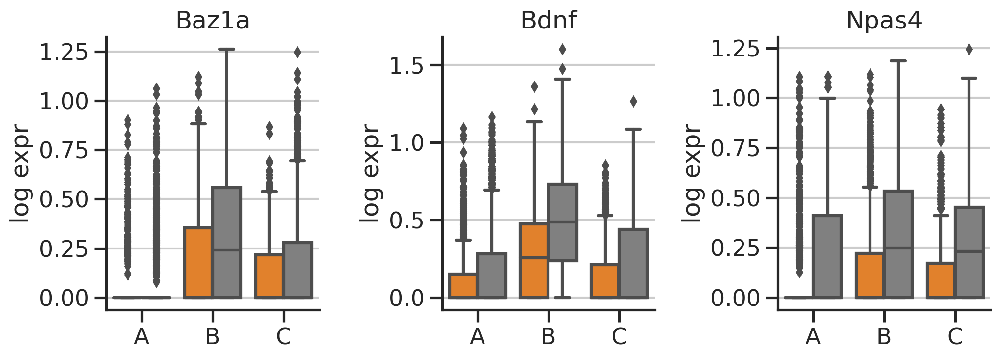

In [56]:
gns = ['Baz1a', 'Bdnf', 'Npas4', 
      ]
plot_gene(adata, gns)

In [57]:
adata_nr = adata[adata.obs.cond=='P28NR'].copy()
adata_dr = adata[adata.obs.cond=='P28DR'].copy()
adata_genes = adata.var.index.values

# NR
cpk_nr = np.array(adata_nr.layers['norm'].todense()) # .reshape(-1,)
mu_nr = np.mean(cpk_nr, axis=0)
sigma_nr = np.std(cpk_nr, axis=0) 
smr_nr = sigma_nr/mu_nr

# DR
cpk_dr = np.array(adata_dr.layers['norm'].todense()) # .reshape(-1,)
mu_dr = np.mean(cpk_dr, axis=0)
sigma_dr = np.std(cpk_dr, axis=0) 
smr_dr = sigma_dr/mu_dr

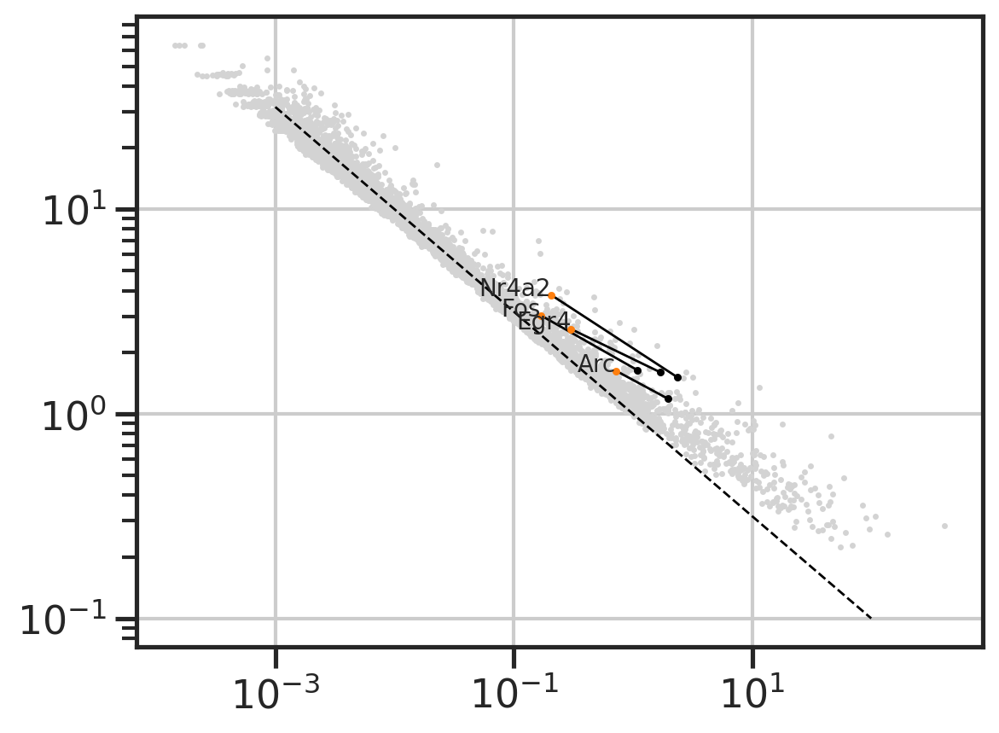

In [58]:
gidx1 = basicu.get_index_from_array(adata_genes, ['Fos', 'Nr4a2', 'Egr4', 'Arc'])
gidx2 = basicu.get_index_from_array(adata_genes, ['Cdh13', 'Trpc6', 'Chrm2'])

plt.scatter(mu_nr, smr_nr, s=1, color='lightgray')
# plt.scatter(mu_dr, smr_dr, s=1)

for gidx in gidx1:
    gn = adata_genes[gidx]
    plt.plot([mu_nr[gidx], mu_dr[gidx]], 
             [smr_nr[gidx], smr_dr[gidx]], '-',
             linewidth=1, color='k', zorder=1,
            )
    plt.scatter(mu_nr[gidx], smr_nr[gidx], s=3, color='C1')
    plt.scatter(mu_dr[gidx], smr_dr[gidx], s=3, color='k')
    plt.text(mu_nr[gidx], smr_nr[gidx], gn, fontsize=10, ha='right')

plt.plot([1e-3, 1, 1e2], 1/np.sqrt([1e-3, 1, 1e2]), color='k', linewidth=1, linestyle='--')
plt.xscale('log')
plt.yscale('log')

# quantify the mixings
# nearest neighbors

In [59]:
cond_nrdr = res['cond'].values
unq_lbls = np.array(['P28NR', 'P28DR'])
emb12 = res[['PC1', 'PC2']].values
emb34 = res[['PC3', 'PC4']].values
k = 30+1

pnrdr12, logratio_ = neighbor_count(k, emb12, cond_nrdr, unq_lbls)
pnrdr34, logratio_ = neighbor_count(k, emb34, cond_nrdr, unq_lbls)

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/1_2024-09-12.pdf
/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/1.pdf


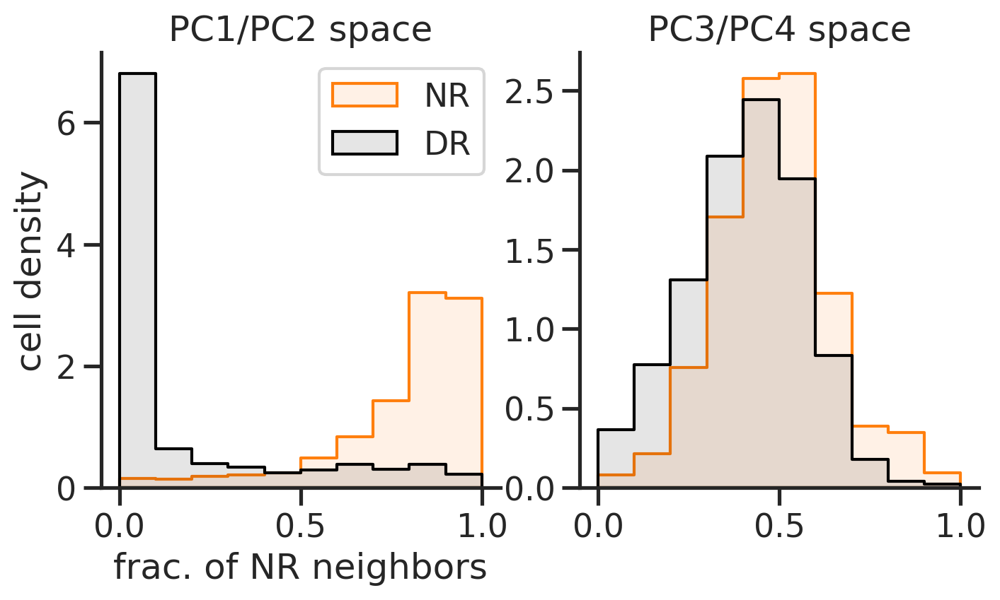

In [60]:
bins = np.linspace(0,1,11)
fig, axs = plt.subplots(1,2,figsize=(2*4,1*4))
ax = axs[0]
sns.histplot(pnrdr12[:,0][cond_nrdr=='P28NR'], stat='density', bins=bins, ax=ax, label='NR', color='C1', element='step', alpha=0.1)
sns.histplot(pnrdr12[:,0][cond_nrdr=='P28DR'], stat='density', bins=bins, ax=ax, label='DR', color='k' , element='step', alpha=0.1)
ax.legend()
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('PC1/PC2 space')
ax.set_xlabel('frac. of NR neighbors')
ax.set_ylabel('cell density')

ax = axs[1]
sns.histplot(pnrdr34[:,0][cond_nrdr=='P28NR'], stat='density', bins=bins, ax=ax, color='C1', element='step', alpha=0.1)
sns.histplot(pnrdr34[:,0][cond_nrdr=='P28DR'], stat='density', bins=bins, ax=ax, color='k' , element='step', alpha=0.1)
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('PC3/PC4 space')
ax.set_ylabel('')
fig_manager.savefig(fig)

In [61]:
cond_abc = res_nr['type'].values
unq_lbls = np.unique(cond_abc) 

emb12 = res_nr[['PC1', 'PC2']].values
emb34 = res_nr[['PC3', 'PC4']].values
k = 30+1

pabc12, logratio_ = neighbor_count(k, emb12, cond_abc, unq_lbls)
pabc34, logratio_ = neighbor_count(k, emb34, cond_abc, unq_lbls)

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/2_2024-09-12.pdf
/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/2.pdf


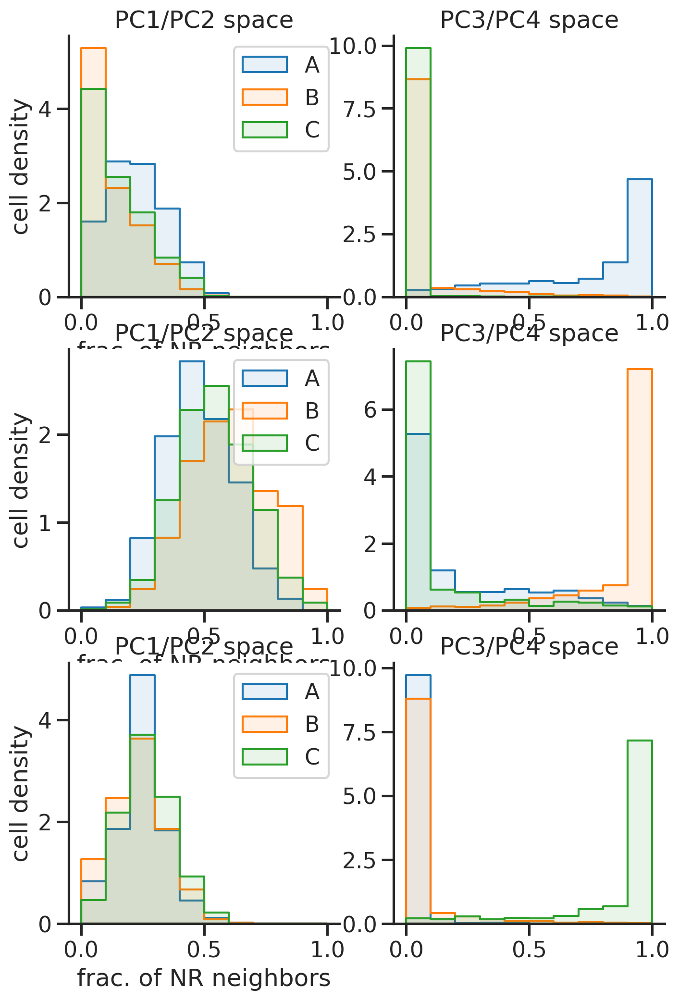

In [62]:
bins = np.linspace(0,1,11)
fig, axs = plt.subplots(3,2,figsize=(2*4,3*4))
for i in range(3):
    ax = axs[i, 0]
    sns.histplot(pabc12[:,i][cond_abc=='L2/3_A'], stat='density', bins=bins, ax=ax, label='A', color='C0', element='step', alpha=0.1)
    sns.histplot(pabc12[:,i][cond_abc=='L2/3_B'], stat='density', bins=bins, ax=ax, label='B', color='C1', element='step', alpha=0.1)
    sns.histplot(pabc12[:,i][cond_abc=='L2/3_C'], stat='density', bins=bins, ax=ax, label='C', color='C2', element='step', alpha=0.1)
    ax.legend()
    sns.despine(ax=ax)
    ax.grid(False)
    ax.set_title('PC1/PC2 space')
    ax.set_xlabel('frac. of NR neighbors')
    ax.set_ylabel('cell density')

    ax = axs[i, 1]
    sns.histplot(pabc34[:,i][cond_abc=='L2/3_A'], stat='density', bins=bins, ax=ax, label='A', color='C0', element='step', alpha=0.1)
    sns.histplot(pabc34[:,i][cond_abc=='L2/3_B'], stat='density', bins=bins, ax=ax, label='B', color='C1', element='step', alpha=0.1)
    sns.histplot(pabc34[:,i][cond_abc=='L2/3_C'], stat='density', bins=bins, ax=ax, label='C', color='C2', element='step', alpha=0.1)
    sns.despine(ax=ax)
    ax.grid(False)
    ax.set_title('PC3/PC4 space')
    ax.set_ylabel('')
fig_manager.savefig(fig)

In [63]:
cond_nrdr = res['cond'].values
unq_lbls = np.array(['P28NR', 'P28DR'])

emb12 = res[['PC1', 'PC2']].values
emb34 = res[['PC3', 'PC4']].values
k = 30+1

pnrdr12, logratio_ = neighbor_count(k, emb12, cond_nrdr, unq_lbls)
pnrdr34, logratio_ = neighbor_count(k, emb34, cond_nrdr, unq_lbls)
psame12_nrdr = np.hstack([
    pnrdr12[:,0][cond_nrdr=='P28NR'],
    pnrdr12[:,1][cond_nrdr=='P28DR'],
])

psame34_nrdr = np.hstack([
    pnrdr34[:,0][cond_nrdr=='P28NR'],
    pnrdr34[:,1][cond_nrdr=='P28DR'],
])



cond_abc = res_nr['type'].values
unq_lbls = np.unique(cond_abc) 
emb12 = res_nr[['PC1', 'PC2']].values
emb34 = res_nr[['PC3', 'PC4']].values
k = 30+1

pabc12, logratio_ = neighbor_count(k, emb12, cond_abc, unq_lbls)
pabc34, logratio_ = neighbor_count(k, emb34, cond_abc, unq_lbls)

psame12_abc = np.hstack([
    pabc12[:,0][cond_abc=='L2/3_A'],
    pabc12[:,1][cond_abc=='L2/3_B'],
    pabc12[:,2][cond_abc=='L2/3_C'],
])
psame34_abc = np.hstack([
    pabc34[:,0][cond_abc=='L2/3_A'],
    pabc34[:,1][cond_abc=='L2/3_B'],
    pabc34[:,2][cond_abc=='L2/3_C'],
])

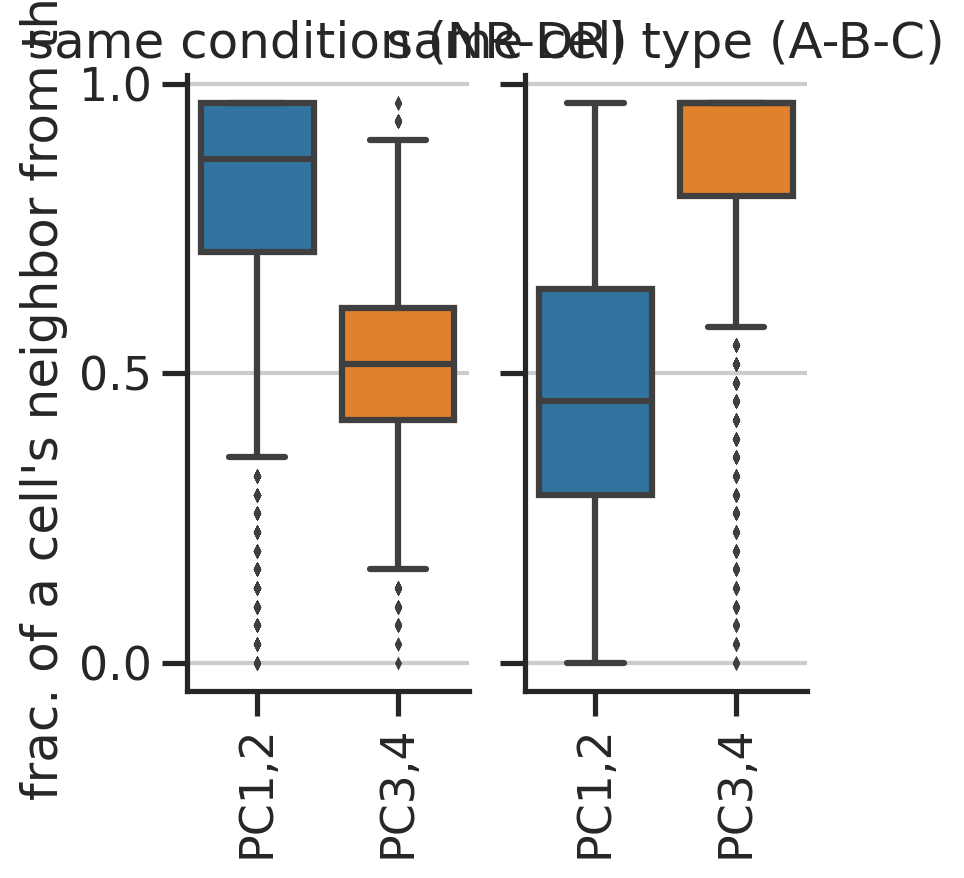

In [64]:
fig, axs = plt.subplots(1,2,figsize=(2*2,1*4), sharey=True) 
ax = axs[0]
# sns.violinplot([psame12_nrdr, psame34_nrdr], cut=0, ax=ax)
sns.boxplot([psame12_nrdr, psame34_nrdr], fliersize=2, ax=ax)
ax.set_xticklabels(['PC1,2', 'PC3,4'], rotation=90)
ax.set_title('same condition (NR-DR)')
ax.set_ylabel("frac. of a cell's neighbor from the")
sns.despine(ax=ax)

ax = axs[1]
# sns.violinplot([psame12_abc, psame34_abc], cut=0, ax=ax)
sns.boxplot([psame12_abc, psame34_abc], fliersize=2, ax=ax)
ax.set_xticklabels(['PC1,2', 'PC3,4'], rotation=90)
ax.set_title('same cell type (A-B-C)')
sns.despine(ax=ax)
ax.set_yticks([0, 0.5, 1])

# fig_manager.savefig(fig)
plt.show()

In [76]:
def nrdr_pipe(cond_nrdr=None):
    if cond_nrdr is None:
        cond_nrdr = res['cond'].values
        
    unq_lbls = np.array(['P28NR', 'P28DR'])
    emb12 = res[['PC1', 'PC2']].values
    emb34 = res[['PC3', 'PC4']].values
    k = 30+1

    pnrdr12, logratio_ = neighbor_count(k, emb12, cond_nrdr, unq_lbls)
    pnrdr34, logratio_ = neighbor_count(k, emb34, cond_nrdr, unq_lbls)
    psame12_nrdr = np.hstack([
        pnrdr12[:,0][cond_nrdr=='P28NR'],
        pnrdr12[:,1][cond_nrdr=='P28DR'],
    ])

    psame34_nrdr = np.hstack([
        pnrdr34[:,0][cond_nrdr=='P28NR'],
        pnrdr34[:,1][cond_nrdr=='P28DR'],
    ])

    # return np.mean(psame12_nrdr), np.mean(psame34_nrdr)
    return psame12_nrdr, psame34_nrdr

def abc_pipe(cond_abc=None):
    if cond_abc is None:
        cond_abc = res_nr['type'].values
        
    unq_lbls = np.unique(cond_abc) 
    emb12 = res_nr[['PC1', 'PC2']].values
    emb34 = res_nr[['PC3', 'PC4']].values
    k = 30+1

    pabc12, logratio_ = neighbor_count(k, emb12, cond_abc, unq_lbls)
    pabc34, logratio_ = neighbor_count(k, emb34, cond_abc, unq_lbls)

    psame12_abc = np.hstack([
        pabc12[:,0][cond_abc=='L2/3_A'],
        pabc12[:,1][cond_abc=='L2/3_B'],
        pabc12[:,2][cond_abc=='L2/3_C'],
    ])
    psame34_abc = np.hstack([
        pabc34[:,0][cond_abc=='L2/3_A'],
        pabc34[:,1][cond_abc=='L2/3_B'],
        pabc34[:,2][cond_abc=='L2/3_C'],
    ])

    # return np.mean(psame12_abc), np.mean(psame34_abc) 
    return psame12_abc, psame34_abc 

In [94]:

from numpy import random
np.random.seed(0)

# allscores = []
# for i in range(10):
#     cond_nrdr_shuff = res['cond'].values.astype(str).copy()
#     random.shuffle(cond_nrdr_shuff) 
#     scores = nrdr_pipe(cond_nrdr=cond_nrdr_shuff)
#     print(scores)
#     allscores.append(scores)
# allscores = np.array(allscores)


scores_data_nr = nrdr_pipe()
cond_nrdr_shuff = res['cond'].values.astype(str).copy()
random.shuffle(cond_nrdr_shuff) 
scores_shff_nr = nrdr_pipe(cond_nrdr=cond_nrdr_shuff)

scores_data_abc = abc_pipe()
cond_abc_shuff = res_nr['type'].values.astype(str).copy()
random.shuffle(cond_abc_shuff) 
scores_shff_abc = abc_pipe(cond_abc=cond_abc_shuff)

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/3_2024-09-12.pdf
/u/home/f/f7xiesnm/project-zipursky/v1-bb/ms_reanalysis/240910-3/3.pdf


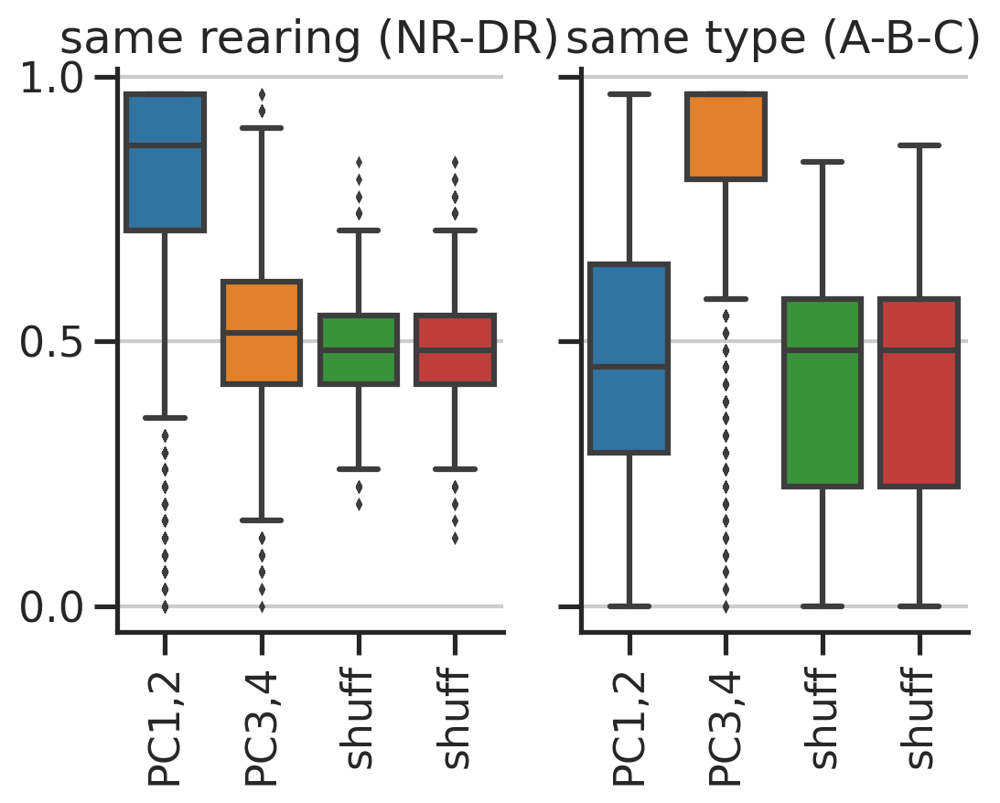

In [111]:
fig, axs = plt.subplots(1,2,figsize=(2*3,1*4), sharey=True) 
ax = axs[0]
sns.boxplot([scores_data_nr[0], scores_data_nr[1], scores_shff_nr[0], scores_shff_nr[1]], fliersize=2, ax=ax) #, c=['C0', 'gray', 'C1', 'gray'])
ax.set_yticks([0, 0.5, 1])
sns.despine(ax=ax)
ax.set_title('same rearing (NR-DR)')
ax.set_xticklabels(['PC1,2', 'PC3,4', 'shuff', 'shuff'], rotation=90)

ax = axs[1]
sns.boxplot([scores_data_abc[0], scores_data_abc[1], scores_shff_abc[0], scores_shff_abc[1]], fliersize=2, ax=ax) #, c=['C0', 'gray', 'C1', 'gray'])
sns.despine(ax=ax)
ax.set_title('same type (A-B-C)')
ax.set_xticklabels(['PC1,2', 'PC3,4', 'shuff', 'shuff'], rotation=90)
fig_manager.savefig(fig)
plt.show()

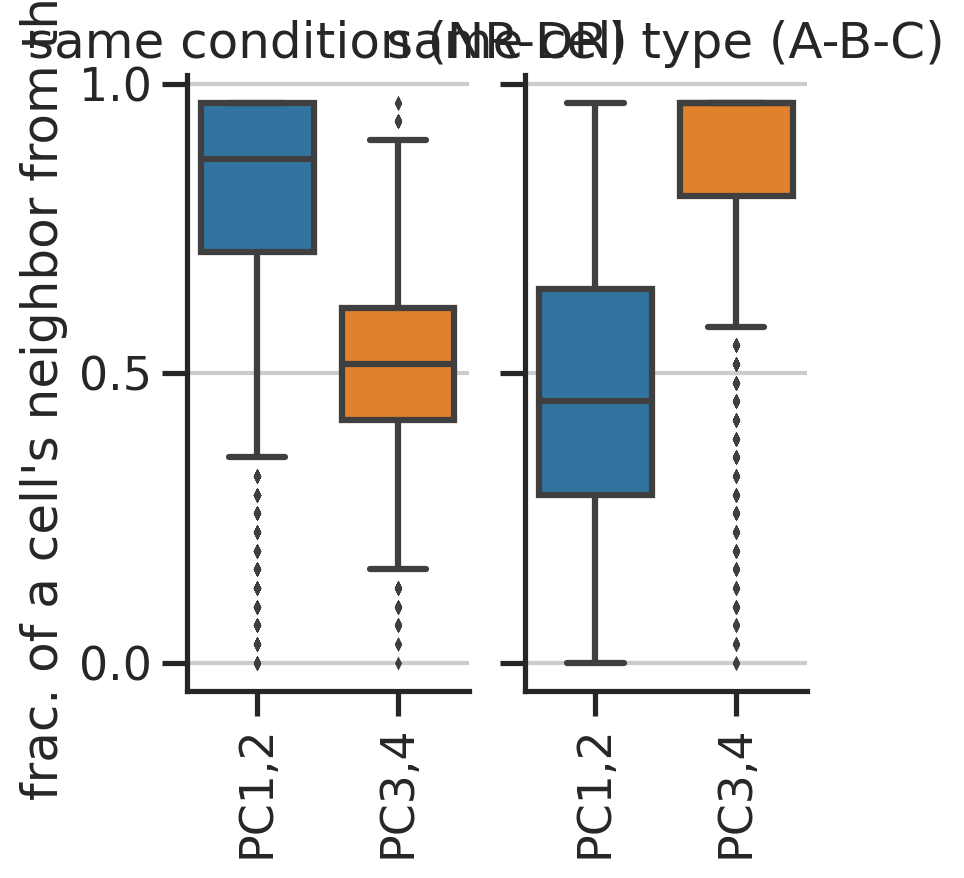

In [94]:
fig, axs = plt.subplots(1,2,figsize=(2*2,1*4), sharey=True) 
ax = axs[0]
# sns.violinplot([psame12_nrdr, psame34_nrdr], cut=0, ax=ax)
sns.boxplot([psame12_nrdr, psame34_nrdr], fliersize=2, ax=ax)
ax.set_xticklabels(['PC1,2', 'PC3,4'], rotation=90)
ax.set_title('same condition (NR-DR)')
ax.set_ylabel("frac. of a cell's neighbor from the")
sns.despine(ax=ax)

ax = axs[1]
# sns.violinplot([psame12_abc, psame34_abc], cut=0, ax=ax)
sns.boxplot([psame12_abc, psame34_abc], fliersize=2, ax=ax)
ax.set_xticklabels(['PC1,2', 'PC3,4'], rotation=90)
ax.set_title('same cell type (A-B-C)')
sns.despine(ax=ax)
ax.set_yticks([0, 0.5, 1])

# fig_manager.savefig(fig)
plt.show()

In [64]:
from scanpy.external.pp import harmony_integrate
from scanpy.external.pp import scanorama_integrate

adata.obsm['X_pca'] = pcs # [:,:10]

In [65]:
harmony_integrate(adata, 'cond', basis='X_pca', adjusted_basis='X_pca_harmony')
# scanorama_integrate(adata, 'cond', basis='X_pca', adjusted_basis='X_pca_harmony')

2024-09-10 11:19:21,989 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-09-10 11:19:24,161 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-09-10 11:19:24,199 - harmonypy - INFO - Iteration 1 of 10
2024-09-10 11:19:25,636 - harmonypy - INFO - Iteration 2 of 10
2024-09-10 11:19:27,140 - harmonypy - INFO - Converged after 2 iterations


In [66]:
for i in range(pcs.shape[1]):
    res[f'PC{i+1}_h'] = adata.obsm['X_pca_harmony'][:,i]

# res['type_knn2'] = np.nan # res_dr['type_knn2']
# res_nr['type_knn2'] = res_nr['type']
# res.update(res_nr)
# res.update(res_dr)
# res

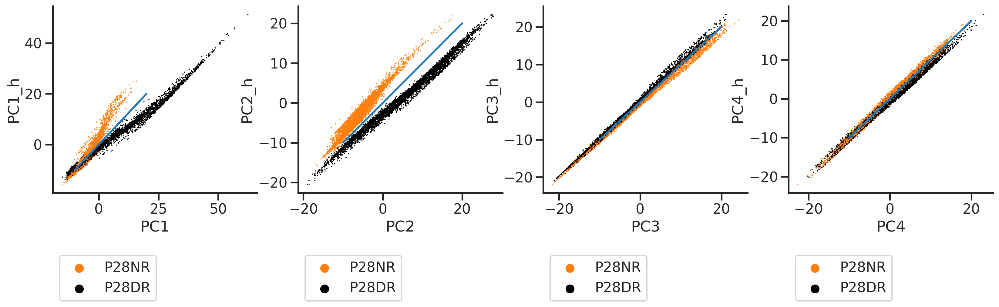

In [67]:

fig, axs = plt.subplots(1,4,figsize=(4*5, 1*4))
for i, ax in enumerate(axs):
    sns.scatterplot(data=res.sample(frac=1, replace=False), x=f'PC{i+1}', y=f'PC{i+1}_h', hue='cond', s=2, 
                    edgecolor='none', 
                    hue_order=list(palette_cond), palette=palette_cond, 
                    ax=ax, rasterized=True)
    ax.plot([-10,20], [-10,20])
    ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
    sns.despine(ax=ax)
    ax.grid(False)


output = os.path.join(outfigdir, "figS1_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

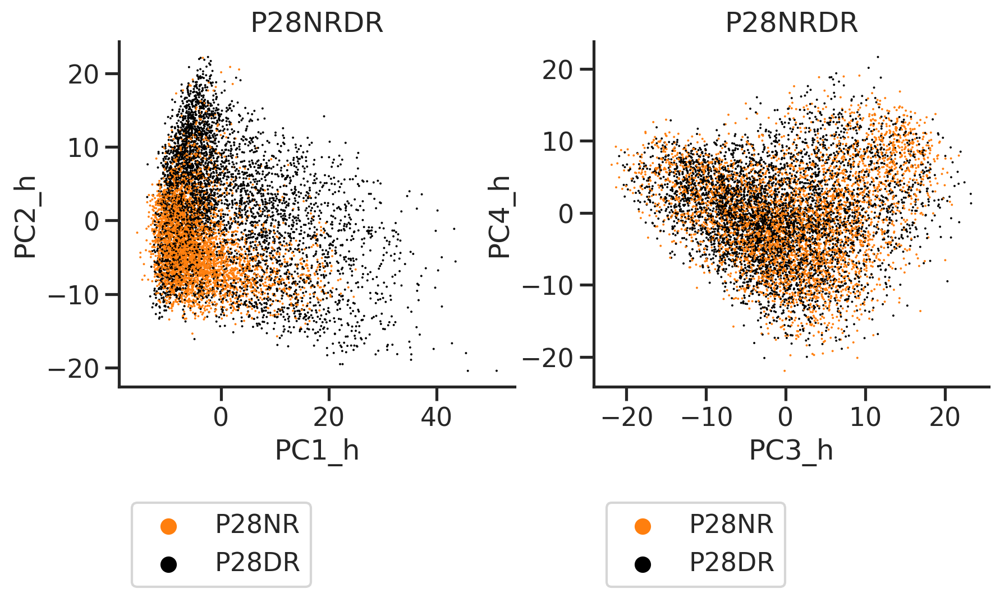

In [68]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4))
ax = axs[0]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC1_h', y='PC2_h', hue='cond', s=2, 
                edgecolor='none', hue_order=list(palette_cond), palette=palette_cond, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

ax = axs[1]
sns.scatterplot(data=res.sample(frac=1, replace=False), x='PC3_h', y='PC4_h', hue='cond', s=2, 
                edgecolor='none', hue_order=list(palette_cond), palette=palette_cond, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')

sns.despine(ax=ax)
ax.grid(False)
ax.set_title('P28NRDR')

output = os.path.join(outfigdir, "figS1_pc12.pdf")
powerplots.savefig(fig, output)
plt.show()

In [69]:
ref_emb = res_nr[['PC3', 'PC4']].values
qry_emb = res_dr[['PC3', 'PC4']].values
ref_lbl = res_nr['type'].values.astype(str)
print(np.unique(ref_lbl))

k = 30
max_pred, gated_pred = neighbor_label_transfer(k, ref_emb, qry_emb, ref_lbl, p_cutoff=0.5, dist_cutoff=3)

res_dr['type_knn'] = max_pred
res_dr['type_knn2'] = gated_pred

['L2/3_A' 'L2/3_B' 'L2/3_C']


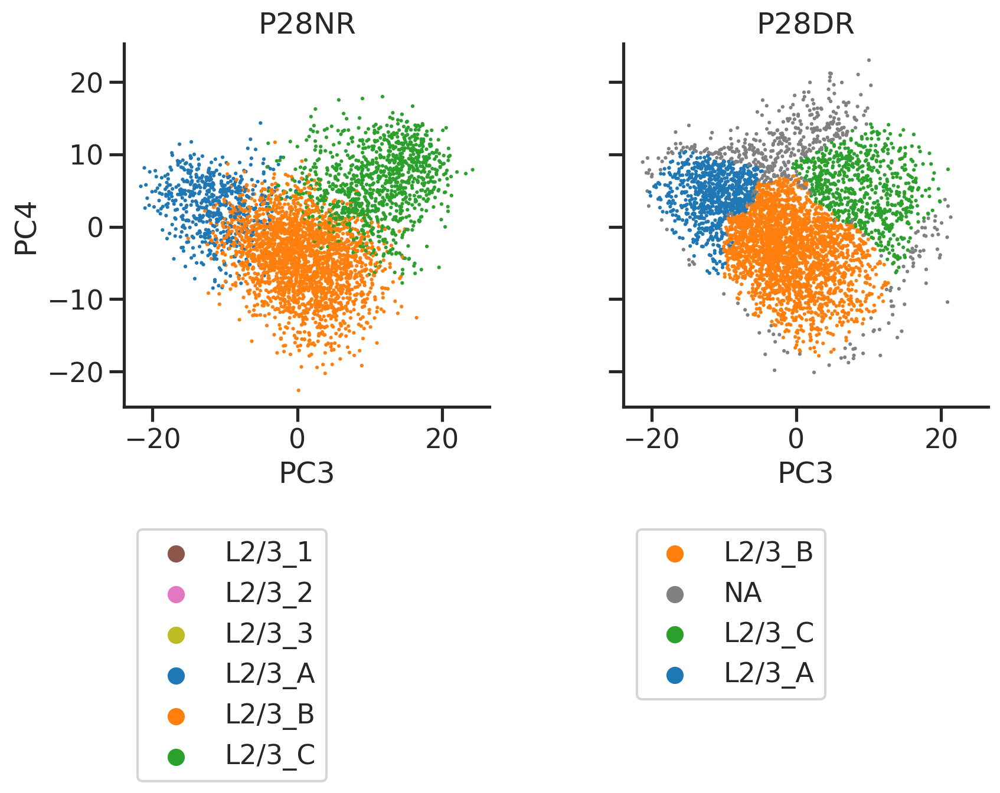

In [70]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res_nr, x='PC3', y='PC4', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28NR')

ax = axs[1]
sns.scatterplot(data=res_dr, x='PC3', y='PC4', hue='type_knn2', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28DR')


# output = os.path.join(outfigdir, "figS1_nr_pc34.pdf")
# powerplots.savefig(fig, output)
plt.show()

In [71]:
res_nr = res[res['cond'].str.contains('NR')].copy()
res_dr = res[res['cond'].str.contains('DR')].copy()
print(res_nr.shape, res_dr.shape)

ref_emb = res_nr[[f'PC{i+1}' for i in range(10)]].values
qry_emb = res_dr[[f'PC{i+1}' for i in range(10)]].values
ref_lbl = res_nr['type'].values.astype(str)
print(np.unique(ref_lbl))

k = 30
max_pred, gated_pred = neighbor_label_transfer(k, ref_emb, qry_emb, ref_lbl, p_cutoff=0.5, dist_cutoff=None)

res_dr['type_knn'] = max_pred
res_dr['type_knn2'] = gated_pred

(4044, 110) (4704, 110)
['L2/3_A' 'L2/3_B' 'L2/3_C']


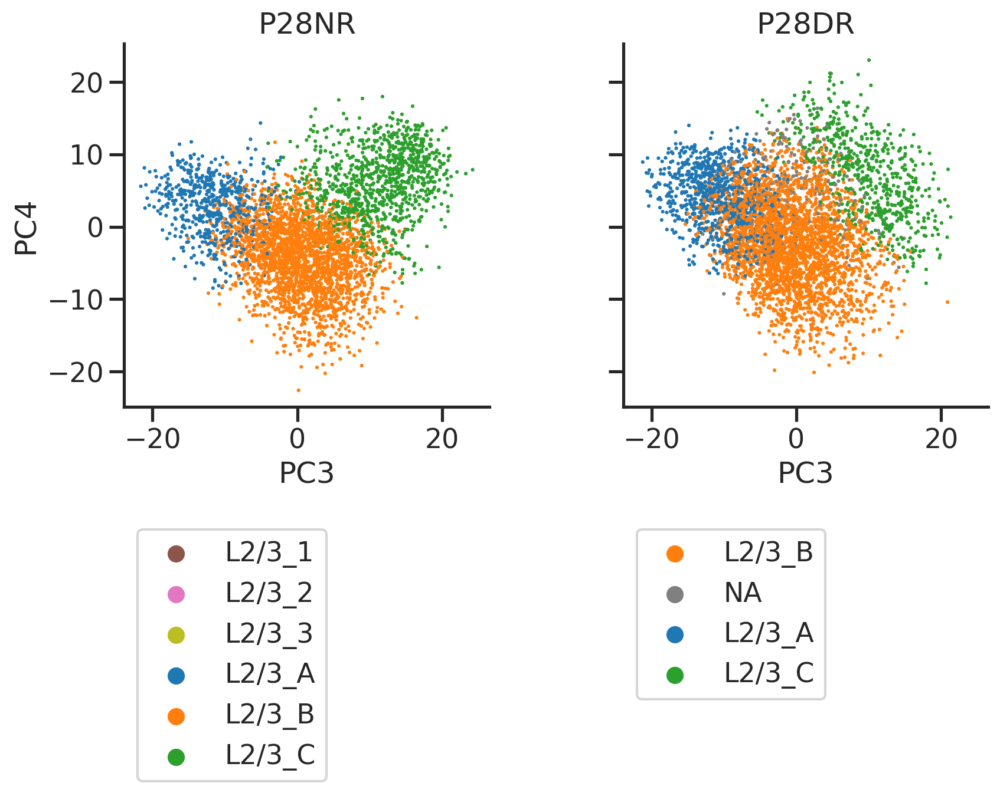

In [72]:
fig, axs = plt.subplots(1,2,figsize=(2*5, 1*4), sharex=True, sharey=True)
ax = axs[0]
sns.scatterplot(data=res_nr.sample(frac=1, replace=False), x='PC3', y='PC4', hue='type', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28NR')

ax = axs[1]
sns.scatterplot(data=res_dr.sample(frac=1, replace=False), x='PC3', y='PC4', hue='type_knn2', s=5, 
                edgecolor='none', palette=palette_type2, ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(0, -0.3), loc='upper left')
sns.despine(ax=ax)
ax.set_aspect('equal')
ax.grid(False)
ax.set_title('P28DR')


# output = os.path.join(outfigdir, "figS1_nr_pc34.pdf")
# powerplots.savefig(fig, output)
plt.show()